In [125]:
import torch
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import make_image_grid
from PIL import Image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    'stabilityai/stable-diffusion-xl-refiner-1.0', torch_dtype=torch.float32, variant='fp16', use_safetensors=True, safety_checker=None
).to('cuda')
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

Keyword arguments {'safety_checker': None} are not expected by StableDiffusionXLImg2ImgPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

Input image size: (1024, 512)


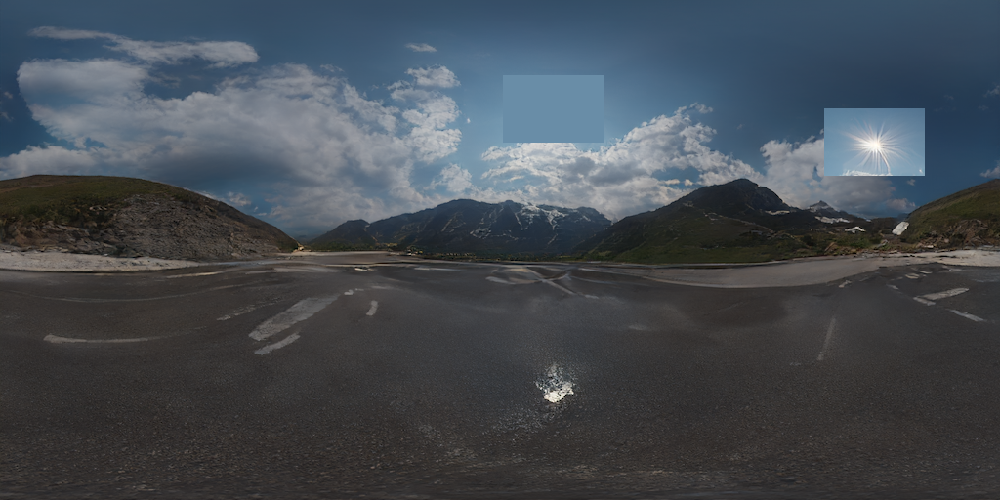

In [4]:
# prepare image
init_image = Image.open('../resources/envmap_edit.png')
print('Input image size:', init_image.size)
make_image_grid([init_image], rows=1, cols=1)

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

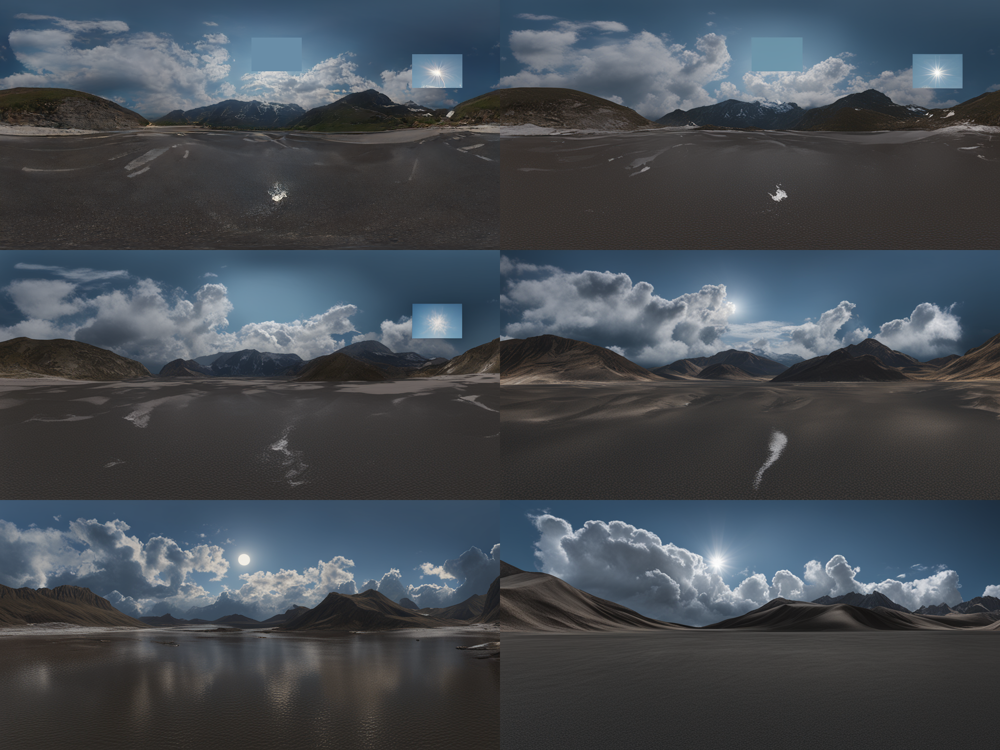

In [5]:
prompt = 'Environment map'

# pass prompt and image to pipeline
image0 = pipeline(prompt, image=init_image, strength=0.2).images[0]
image1 = pipeline(prompt, image=init_image, strength=0.3).images[0]
image2 = pipeline(prompt, image=init_image, strength=0.4).images[0]
image3 = pipeline(prompt, image=init_image, strength=0.5).images[0]
image4 = pipeline(prompt, image=init_image, strength=0.6).images[0]

make_image_grid([init_image, image0, image1, image2, image3, image4], rows=3, cols=2)

  0%|          | 0/20 [00:00<?, ?it/s]

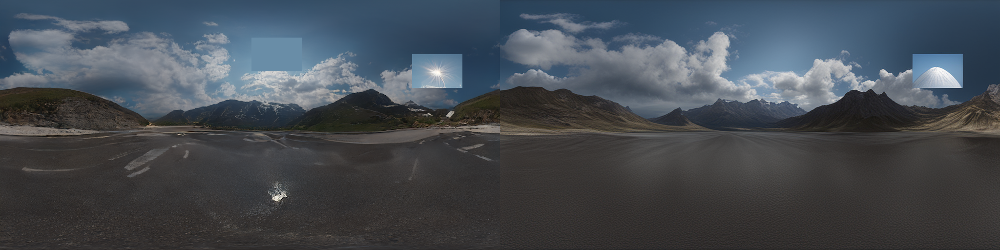

In [6]:
prompt = 'Equirectangular environment map'
negative_prompt = 'boxes, artifacts'

# pass prompt and image to pipeline
image = pipeline(prompt, image=init_image, negative_prompt=negative_prompt, strength=0.4).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

  0%|          | 0/20 [00:00<?, ?it/s]

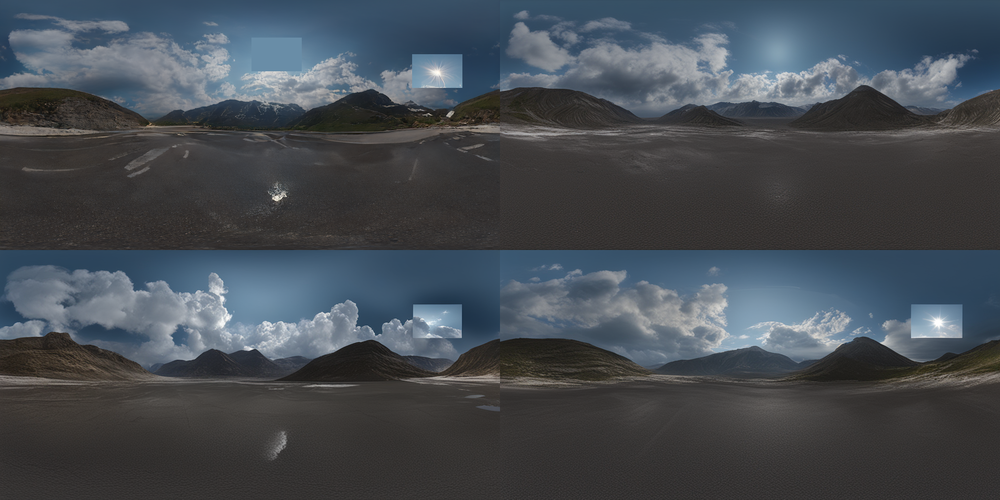

In [5]:
# pass prompt and image to pipeline
images = pipeline(prompt, image=init_image, negative_prompt=negative_prompt, strength=0.4, num_images_per_prompt=3).images
make_image_grid([init_image] + images, rows=2, cols=2)

In [8]:
from diffusers import AutoPipelineForInpainting

inpaint_pipeline = AutoPipelineForInpainting.from_pretrained(
    'diffusers/stable-diffusion-xl-1.0-inpainting-0.1', torch_dtype=torch.float16, variant='fp16'
).to('cuda')
inpaint_pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'decay': 0.9999, 'inv_gamma': 1.0, 'min_decay': 0.0, 'optimization_step': 37000, 'power': 0.6666666666666666, 'update_after_step': 0, 'use_ema_warmup': False} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


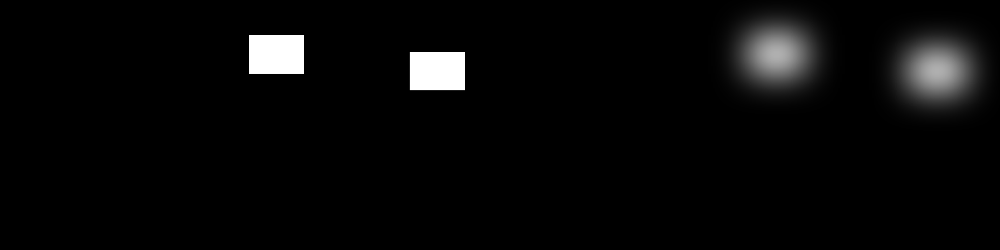

In [7]:
# mask image
mask_image = Image.open('../resources/mask.png')
blurred_mask = inpaint_pipeline.mask_processor.blur(mask_image, blur_factor=33)

make_image_grid([mask_image, blurred_mask], rows=1, cols=2)

  0%|          | 0/20 [00:00<?, ?it/s]

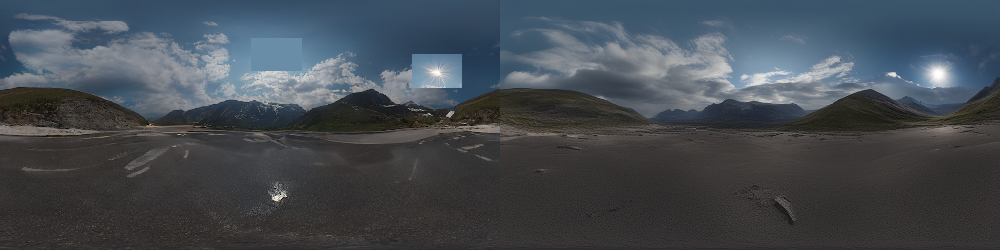

In [8]:
image = pipeline(prompt, image=init_image, mask_image=blurred_mask, negative_prompt=negative_prompt, strength=0.4).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

  0%|          | 0/49 [00:00<?, ?it/s]

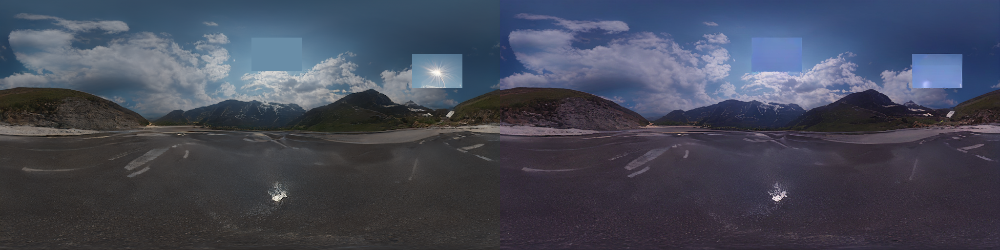

In [9]:
image = inpaint_pipeline(prompt, image=init_image, mask_image=blurred_mask, negative_prompt=negative_prompt, height=512, width=1024).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

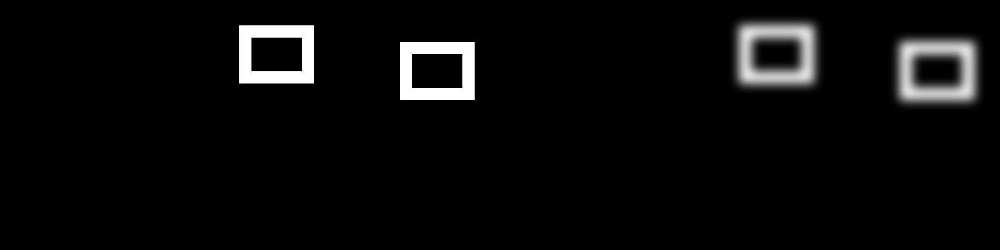

In [13]:
# mask image
mask_image = Image.open('../resources/edge_mask.png')
blurred_mask = inpaint_pipeline.mask_processor.blur(mask_image, blur_factor=10)

make_image_grid([mask_image, blurred_mask], rows=1, cols=2)

  0%|          | 0/49 [00:00<?, ?it/s]

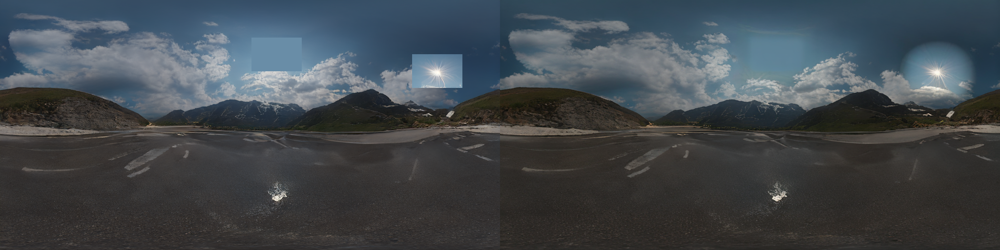

In [11]:
image = inpaint_pipeline(prompt, image=init_image, mask_image=mask_image, negative_prompt=negative_prompt, height=512, width=1024).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

  0%|          | 0/20 [00:00<?, ?it/s]

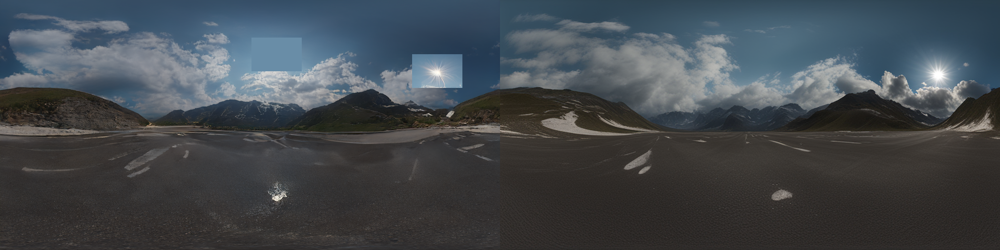

In [12]:
pipe_image = pipeline(prompt, image=image, negative_prompt=negative_prompt, strength=0.4).images[0]
make_image_grid([init_image, pipe_image], rows=1, cols=2)

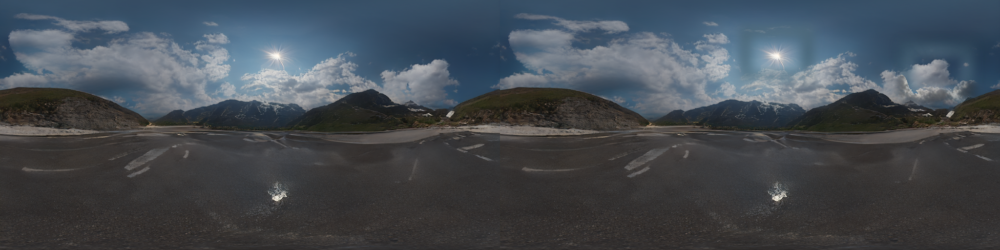

In [13]:
from diffusers.image_processor import VaeImageProcessor

image_processor = VaeImageProcessor()
orig_image = Image.open('../resources/envmap.png')

comp_image = image_processor.apply_overlay(blurred_mask, orig_image, pipe_image)

make_image_grid([orig_image, comp_image], rows=1, cols=2)

In [148]:
from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_img2img import *
from diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_inpaint import prepare_mask_and_masked_image


class myStableDiffusionImg2ImgPipeline(StableDiffusionImg2ImgPipeline):
    def __init__(
        self,
        vae: AutoencoderKL,
        text_encoder: CLIPTextModel,
        tokenizer: CLIPTokenizer,
        unet: UNet2DConditionModel,
        scheduler: KarrasDiffusionSchedulers,
        safety_checker: StableDiffusionSafetyChecker,
        feature_extractor: CLIPImageProcessor,
        image_encoder: CLIPVisionModelWithProjection = None,
        requires_safety_checker: bool = True,
    ):
        super(myStableDiffusionImg2ImgPipeline, self).__init__(
            vae, text_encoder, tokenizer, unet, scheduler, safety_checker, feature_extractor, image_encoder, requires_safety_checker
        )

        self.mask_processor = VaeImageProcessor(
            vae_scale_factor=self.vae_scale_factor, do_normalize=False, do_binarize=True, do_convert_grayscale=True
        )

    def _encode_vae_image(self, image: torch.Tensor, generator: torch.Generator):
        if isinstance(generator, list):
            image_latents = [
                retrieve_latents(self.vae.encode(image[i : i + 1]), generator=generator[i])
                for i in range(image.shape[0])
            ]
            image_latents = torch.cat(image_latents, dim=0)
        else:
            image_latents = retrieve_latents(self.vae.encode(image), generator=generator)

        image_latents = self.vae.config.scaling_factor * image_latents

        return image_latents

    def prepare_mask_latents(
        self, mask, masked_image, batch_size, height, width, dtype, device, generator, do_classifier_free_guidance
    ):
        # resize the mask to latents shape as we concatenate the mask to the latents
        # we do that before converting to dtype to avoid breaking in case we're using cpu_offload
        # and half precision
        mask = torch.nn.functional.interpolate(
            mask, size=(height // self.vae_scale_factor, width // self.vae_scale_factor)
        )
        mask = mask.to(device=device, dtype=dtype)

        masked_image = masked_image.to(device=device, dtype=dtype)

        if masked_image.shape[1] == 4:
            masked_image_latents = masked_image
        else:
            masked_image_latents = self._encode_vae_image(masked_image, generator=generator)

        # duplicate mask and masked_image_latents for each generation per prompt, using mps friendly method
        if mask.shape[0] < batch_size:
            if not batch_size % mask.shape[0] == 0:
                raise ValueError(
                    "The passed mask and the required batch size don't match. Masks are supposed to be duplicated to"
                    f" a total batch size of {batch_size}, but {mask.shape[0]} masks were passed. Make sure the number"
                    " of masks that you pass is divisible by the total requested batch size."
                )
            mask = mask.repeat(batch_size // mask.shape[0], 1, 1, 1)
        if masked_image_latents.shape[0] < batch_size:
            if not batch_size % masked_image_latents.shape[0] == 0:
                raise ValueError(
                    "The passed images and the required batch size don't match. Images are supposed to be duplicated"
                    f" to a total batch size of {batch_size}, but {masked_image_latents.shape[0]} images were passed."
                    " Make sure the number of images that you pass is divisible by the total requested batch size."
                )
            masked_image_latents = masked_image_latents.repeat(batch_size // masked_image_latents.shape[0], 1, 1, 1)

        mask = torch.cat([mask] * 2) if do_classifier_free_guidance else mask
        masked_image_latents = (
            torch.cat([masked_image_latents] * 2) if do_classifier_free_guidance else masked_image_latents
        )

        # aligning device to prevent device errors when concating it with the latent model input
        masked_image_latents = masked_image_latents.to(device=device, dtype=dtype)
        return mask, masked_image_latents
    
    def prepare_latents(
        self,
        batch_size,
        num_channels_latents,
        height,
        width,
        dtype,
        device,
        generator,
        latents=None,
        image=None,
        timestep=None,
        is_strength_max=True,
        return_noise=False,
        return_image_latents=False,
    ):
        shape = (
            batch_size,
            num_channels_latents,
            int(height) // self.vae_scale_factor,
            int(width) // self.vae_scale_factor,
        )
        if isinstance(generator, list) and len(generator) != batch_size:
            raise ValueError(
                f"You have passed a list of generators of length {len(generator)}, but requested an effective batch"
                f" size of {batch_size}. Make sure the batch size matches the length of the generators."
            )

        if (image is None or timestep is None) and not is_strength_max:
            raise ValueError(
                "Since strength < 1. initial latents are to be initialised as a combination of Image + Noise."
                "However, either the image or the noise timestep has not been provided."
            )

        if return_image_latents or (latents is None and not is_strength_max):
            image = image.to(device=device, dtype=dtype)

            if image.shape[1] == 4:
                image_latents = image
            else:
                image_latents = self._encode_vae_image(image=image, generator=generator)
            image_latents = image_latents.repeat(batch_size // image_latents.shape[0], 1, 1, 1)

        if latents is None:
            noise = randn_tensor(shape, generator=generator, device=device, dtype=dtype)
            # if strength is 1. then initialise the latents to noise, else initial to image + noise
            latents = noise if is_strength_max else self.scheduler.add_noise(image_latents, noise, timestep)
            # if pure noise then scale the initial latents by the  Scheduler's init sigma
            latents = latents * self.scheduler.init_noise_sigma if is_strength_max else latents
        else:
            noise = latents.to(device)
            latents = noise * self.scheduler.init_noise_sigma

        outputs = (latents,)

        if return_noise:
            outputs += (noise,)

        if return_image_latents:
            outputs += (image_latents,)

        return outputs

    @torch.no_grad()
    def __call__(
        self,
        prompt: Union[str, List[str]] = None,
        image: PipelineImageInput = None,
        strength: float = 0.8,
        num_inference_steps: Optional[int] = 50,
        timesteps: List[int] = None,
        guidance_scale: Optional[float] = 7.5,
        negative_prompt: Optional[Union[str, List[str]]] = None,
        num_images_per_prompt: Optional[int] = 1,
        eta: Optional[float] = 0.0,
        generator: Optional[Union[torch.Generator, List[torch.Generator]]] = None,
        prompt_embeds: Optional[torch.FloatTensor] = None,
        negative_prompt_embeds: Optional[torch.FloatTensor] = None,
        ip_adapter_image: Optional[PipelineImageInput] = None,
        ip_adapter_image_embeds: Optional[List[torch.FloatTensor]] = None,
        output_type: Optional[str] = "pil",
        return_dict: bool = True,
        cross_attention_kwargs: Optional[Dict[str, Any]] = None,
        clip_skip: int = None,
        callback_on_step_end: Optional[Callable[[int, int, Dict], None]] = None,
        callback_on_step_end_tensor_inputs: List[str] = ["latents"],
        # MASK
        height: Optional[int] = None,
        width: Optional[int] = None,
        padding_mask_crop: Optional[int] = None,
        latents: Optional[torch.FloatTensor] = None,
        mask_image: PipelineImageInput = None,
        masked_image_latents: torch.FloatTensor = None,
        **kwargs,
    ):
        callback = kwargs.pop("callback", None)
        callback_steps = kwargs.pop("callback_steps", None)

        if callback is not None:
            deprecate(
                "callback",
                "1.0.0",
                "Passing `callback` as an input argument to `__call__` is deprecated, consider use `callback_on_step_end`",
            )
        if callback_steps is not None:
            deprecate(
                "callback_steps",
                "1.0.0",
                "Passing `callback_steps` as an input argument to `__call__` is deprecated, consider use `callback_on_step_end`",
            )

        # 0. Default height and width to unet
        height = height or self.unet.config.sample_size * self.vae_scale_factor
        width = width or self.unet.config.sample_size * self.vae_scale_factor

        # 1. Check inputs. Raise error if not correct
        self.check_inputs(
            prompt,
            strength,
            callback_steps,
            negative_prompt,
            prompt_embeds,
            negative_prompt_embeds,
            ip_adapter_image,
            ip_adapter_image_embeds,
            callback_on_step_end_tensor_inputs,
        )

        self._guidance_scale = guidance_scale
        self._clip_skip = clip_skip
        self._cross_attention_kwargs = cross_attention_kwargs
        self._interrupt = False

        # 2. Define call parameters
        if prompt is not None and isinstance(prompt, str):
            batch_size = 1
        elif prompt is not None and isinstance(prompt, list):
            batch_size = len(prompt)
        else:
            batch_size = prompt_embeds.shape[0]

        device = self._execution_device

        # 3. Encode input prompt
        text_encoder_lora_scale = (
            self.cross_attention_kwargs.get("scale", None) if self.cross_attention_kwargs is not None else None
        )
        prompt_embeds, negative_prompt_embeds = self.encode_prompt(
            prompt,
            device,
            num_images_per_prompt,
            self.do_classifier_free_guidance,
            negative_prompt,
            prompt_embeds=prompt_embeds,
            negative_prompt_embeds=negative_prompt_embeds,
            lora_scale=text_encoder_lora_scale,
            clip_skip=self.clip_skip,
        )
        # For classifier free guidance, we need to do two forward passes.
        # Here we concatenate the unconditional and text embeddings into a single batch
        # to avoid doing two forward passes
        if self.do_classifier_free_guidance:
            prompt_embeds = torch.cat([negative_prompt_embeds, prompt_embeds])

        if ip_adapter_image is not None or ip_adapter_image_embeds is not None:
            image_embeds = self.prepare_ip_adapter_image_embeds(
                ip_adapter_image,
                ip_adapter_image_embeds,
                device,
                batch_size * num_images_per_prompt,
                self.do_classifier_free_guidance,
            )

        # 4. Preprocess image
        if padding_mask_crop is not None:
            crops_coords = self.mask_processor.get_crop_region(mask_image, width, height, pad=padding_mask_crop)
            resize_mode = "fill"
        else:
            crops_coords = None
            resize_mode = "default"

        init_image = self.image_processor.preprocess(
            image, height=height, width=width, crops_coords=crops_coords, resize_mode=resize_mode
        )
        image = init_image.to(dtype=torch.float32)

        # 5. set timesteps
        timesteps, num_inference_steps = retrieve_timesteps(self.scheduler, num_inference_steps, device, timesteps)
        timesteps, num_inference_steps = self.get_timesteps(num_inference_steps, strength, device)
        latent_timestep = timesteps[:1].repeat(batch_size * num_images_per_prompt)

        # 6. Prepare latent variables
        num_channels_latents = self.vae.config.latent_channels
        num_channels_unet = self.unet.config.in_channels
        return_image_latents = num_channels_unet == 4

        is_strength_max = strength == 1.0

        latents_outputs = self.prepare_latents(
            batch_size * num_images_per_prompt,
            num_channels_latents,
            height,
            width,
            prompt_embeds.dtype,
            device,
            generator,
            latents,
            image=init_image,
            timestep=latent_timestep,
            is_strength_max=is_strength_max,
            return_noise=True,
            return_image_latents=return_image_latents,
        )

        if return_image_latents:
            latents, noise, image_latents = latents_outputs
        else:
            latents, noise = latents_outputs

        # 6.1 Prepare mask latent variables
        mask_condition = self.mask_processor.preprocess(
            mask_image, height=height, width=width, resize_mode=resize_mode, crops_coords=crops_coords
        )

        if masked_image_latents is None:
            masked_image = init_image * (mask_condition < 0.5)
        else:
            masked_image = masked_image_latents

        mask, masked_image_latents = self.prepare_mask_latents(
            mask_condition,
            masked_image,
            batch_size * num_images_per_prompt,
            height,
            width,
            prompt_embeds.dtype,
            device,
            generator,
            self.do_classifier_free_guidance,
        )

        # 6.2 Check that sizes of mask, masked image and latents match
        if num_channels_unet == 9:
            # default case for runwayml/stable-diffusion-inpainting
            num_channels_mask = mask.shape[1]
            num_channels_masked_image = masked_image_latents.shape[1]
            if num_channels_latents + num_channels_mask + num_channels_masked_image != self.unet.config.in_channels:
                raise ValueError(
                    f"Incorrect configuration settings! The config of `pipeline.unet`: {self.unet.config} expects"
                    f" {self.unet.config.in_channels} but received `num_channels_latents`: {num_channels_latents} +"
                    f" `num_channels_mask`: {num_channels_mask} + `num_channels_masked_image`: {num_channels_masked_image}"
                    f" = {num_channels_latents+num_channels_masked_image+num_channels_mask}. Please verify the config of"
                    " `pipeline.unet` or your `mask_image` or `image` input."
                )
        elif num_channels_unet != 4:
            raise ValueError(
                f"The unet {self.unet.__class__} should have either 4 or 9 input channels, not {self.unet.config.in_channels}."
            )

        # 7. Prepare extra step kwargs. TODO: Logic should ideally just be moved out of the pipeline
        extra_step_kwargs = self.prepare_extra_step_kwargs(generator, eta)

        # 7.1 Add image embeds for IP-Adapter
        added_cond_kwargs = (
            {"image_embeds": image_embeds}
            if ip_adapter_image is not None or ip_adapter_image_embeds is not None
            else None
        )

        # 7.2 Optionally get Guidance Scale Embedding
        timestep_cond = None
        if self.unet.config.time_cond_proj_dim is not None:
            guidance_scale_tensor = torch.tensor(self.guidance_scale - 1).repeat(batch_size * num_images_per_prompt)
            timestep_cond = self.get_guidance_scale_embedding(
                guidance_scale_tensor, embedding_dim=self.unet.config.time_cond_proj_dim
            ).to(device=device, dtype=latents.dtype)

        # 8. Denoising loop
        num_warmup_steps = len(timesteps) - num_inference_steps * self.scheduler.order
        self._num_timesteps = len(timesteps)
        with self.progress_bar(total=num_inference_steps) as progress_bar:
            for i, t in enumerate(timesteps):
                if self.interrupt:
                    continue

                # expand the latents if we are doing classifier free guidance
                latent_model_input = torch.cat([latents] * 2) if self.do_classifier_free_guidance else latents
                latent_model_input = self.scheduler.scale_model_input(latent_model_input, t)

                if num_channels_unet == 9:
                    latent_model_input = torch.cat([latent_model_input, mask, masked_image_latents], dim=1)

                # predict the noise residual
                noise_pred = self.unet(
                    latent_model_input,
                    t,
                    encoder_hidden_states=prompt_embeds,
                    timestep_cond=timestep_cond,
                    cross_attention_kwargs=self.cross_attention_kwargs,
                    added_cond_kwargs=added_cond_kwargs,
                    return_dict=False,
                )[0]

                # perform guidance
                if self.do_classifier_free_guidance:
                    noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
                    noise_pred = noise_pred_uncond + self.guidance_scale * (noise_pred_text - noise_pred_uncond)

                # compute the previous noisy sample x_t -> x_t-1
                latents = self.scheduler.step(noise_pred, t, latents, **extra_step_kwargs, return_dict=False)[0]

                if num_channels_unet == 4:
                    init_latents_proper = image_latents
                    if self.do_classifier_free_guidance:
                        init_mask, _ = mask.chunk(2)
                    else:
                        init_mask = mask

                    if i < len(timesteps) - 1:
                        noise_timestep = timesteps[i + 1]
                        init_latents_proper = self.scheduler.add_noise(
                            init_latents_proper, noise, torch.tensor([noise_timestep])
                        )

                    latents = (1 - init_mask) * init_latents_proper + init_mask * latents

                if callback_on_step_end is not None:
                    callback_kwargs = {}
                    for k in callback_on_step_end_tensor_inputs:
                        callback_kwargs[k] = locals()[k]
                    callback_outputs = callback_on_step_end(self, i, t, callback_kwargs)

                    latents = callback_outputs.pop("latents", latents)
                    prompt_embeds = callback_outputs.pop("prompt_embeds", prompt_embeds)
                    negative_prompt_embeds = callback_outputs.pop("negative_prompt_embeds", negative_prompt_embeds)

                # call the callback, if provided
                if i == len(timesteps) - 1 or ((i + 1) > num_warmup_steps and (i + 1) % self.scheduler.order == 0):
                    progress_bar.update()
                    if callback is not None and i % callback_steps == 0:
                        step_idx = i // getattr(self.scheduler, "order", 1)
                        callback(step_idx, t, latents)

        if not output_type == "latent":
            image = self.vae.decode(latents / self.vae.config.scaling_factor, return_dict=False, generator=generator)[
                0
            ]
            image, has_nsfw_concept = self.run_safety_checker(image, device, prompt_embeds.dtype)
        else:
            image = latents
            has_nsfw_concept = None

        if has_nsfw_concept is None:
            do_denormalize = [True] * image.shape[0]
        else:
            do_denormalize = [not has_nsfw for has_nsfw in has_nsfw_concept]

        image = self.image_processor.postprocess(image, output_type=output_type, do_denormalize=do_denormalize)

        # Offload all models
        self.maybe_free_model_hooks()

        if not return_dict:
            return (image, has_nsfw_concept)

        return StableDiffusionPipelineOutput(images=image, nsfw_content_detected=has_nsfw_concept)

In [196]:
my_pipeline = myStableDiffusionImg2ImgPipeline.from_pretrained(
    'runwayml/stable-diffusion-v1-5', torch_dtype=torch.float16, variant='fp16', use_safetensors=True, safety_checker=None
).to('cuda')
my_pipeline.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class '__main__.myStableDiffusionImg2ImgPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/25 [00:00<?, ?it/s]

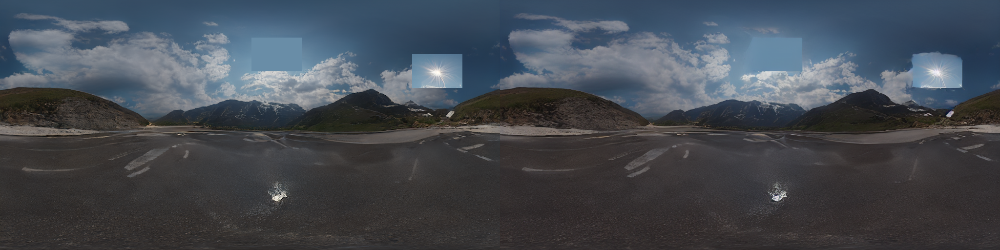

In [15]:
image = my_pipeline(prompt, image=init_image, mask_image=blurred_mask, negative_prompt=negative_prompt, height=512, width=1024, strength=0.5).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

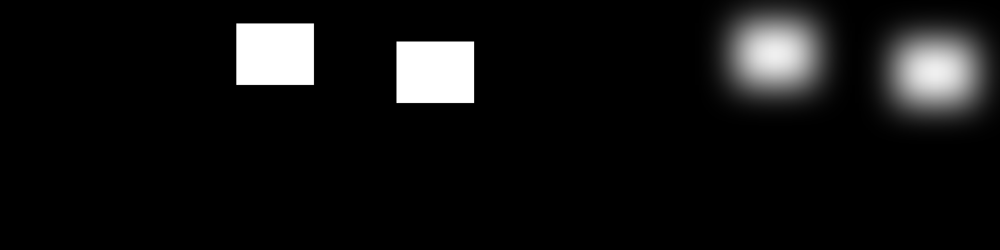

In [16]:
# mask image
mask_image = Image.open('../resources/enlarged_mask.png')
blurred_mask = inpaint_pipeline.mask_processor.blur(mask_image, blur_factor=33)

make_image_grid([mask_image, blurred_mask], rows=1, cols=2)

  0%|          | 0/25 [00:00<?, ?it/s]

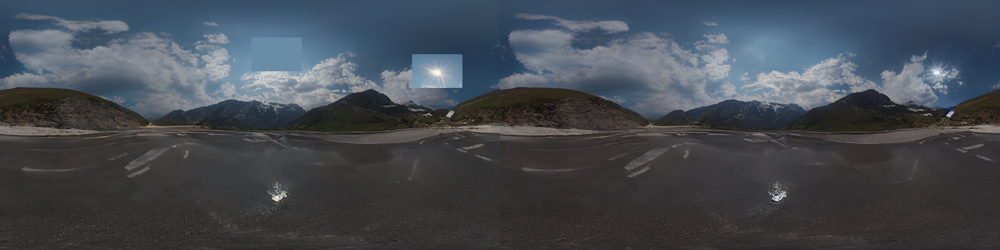

In [18]:
image = my_pipeline(prompt, image=init_image, mask_image=blurred_mask, negative_prompt=negative_prompt, height=512, width=1024, strength=0.5).images[0]
make_image_grid([init_image, image], rows=1, cols=2)